In [1]:
import os
import sys
import geopandas as gpd
import pandas as pd
from scipy.stats import pearsonr, spearmanr
from sklearn.feature_selection import mutual_info_regression
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
import matplotlib.pyplot as plt
import numpy as np
import altair as alt
from mpl_toolkits.mplot3d import Axes3D
alt.data_transformers.enable("vegafusion")
import warnings
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
warnings.filterwarnings('ignore')

In [2]:
sys.path.append("../../src")
import main
import vis

In [11]:
temp =  pd.read_csv('/Users/lisawink/Documents/paper1/data/gap_filled_data_ta_rh.csv')
temp['datetime_UTC']=pd.to_datetime(temp['datetime_UTC'])
temp = temp[temp['variable']=='Ta_deg_C']

temp['datetime_UTC'] = temp['datetime_UTC'].astype(str)
temp = temp.pivot(index='station_id', columns='datetime_UTC', values='value')

In [37]:
# Define station IDs
stations = ['FRASHA', 'FRBETZ', 'FRBRUH', 'FRDREI', 'FRFRIE', 'FRGART', 'FRGLBA',
            'FRGUNT', 'FRHAID', 'FRHBHF', 'FRHERD', 'FRHOLZ', 'FRIHOC', 'FRINST',
            'FRKART', 'FRLAND', 'FRLORE', 'FRMESS', 'FROWIE', 'FRPDAS', 'FRRIES',
            'FRSEEP', 'FRSTGA', 'FRSTGE', 'FRSTUH', 'FRUNIK', 'FRUWIE', 'FRVAUB',
            'FRWEIN', 'FRWSEE', 'FRZAHR']

# Create a colormap (e.g., using the 'tab20' color palette)
cmap = plt.get_cmap('tab20', len(stations))  # 31 unique colors
station_colors = {station: cmap(i) for i, station in enumerate(stations)}  # Map station to color

In [8]:
radius = 1000


In [13]:
vars = gpd.read_parquet(f'/Users/lisawink/Documents/paper1/data/processed_data/processed_station_params_{radius}.parquet')
vars.index = vars['station_id']
to_remove = ['station_id','station_no','station_name','station_long_name','station_type','station_lat','station_lon','mounting_structure','dominant_land_use','local_climate_zone','urban_atlas_class','urban_atlas_code','SVF_3D']
vars = vars.drop(to_remove, axis=1)
df = vars.merge(temp, left_on='station_id', right_on='station_id',how='inner')

In [64]:
df.explore(column='2023-08-12 13:00:00+00:00', cmap='viridis', legend=True, tooltip=['station_id', 'SVF_3D_mean','2023-08-07 13:00:00+00:00'], marker_kwds={'radius': 15}, tiles='CartoDB positron')

200 m

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from ipywidgets import interact


# Create dropdown widgets for selecting the parameter and time
parameter_dropdown = widgets.Dropdown(
    options=vars.columns.tolist(),
    value='StrHW_median',
    description='Parameter:',
)

time_dropdown = widgets.Dropdown(
    options=temp.columns.tolist(),
    value='2023-08-31 21:00:00+00:00',
    description='Time:',
)

   

# Define a function to update the scatter plot based on the selected parameter and time
def update_plot(parameter, time):

    plt.figure(figsize=(10, 6))
    plt.scatter(df[parameter], df[time])
    
    for i, txt in enumerate(df.index):
        plt.annotate(txt, (df[parameter].iloc[i], df[time].iloc[i]))
    
    plt.xlabel(parameter)
    plt.ylabel('Station ID')
    plt.title(f'Scatter Plot of {parameter} at {time}')
    plt.show()

# Use ipywidgets.interact to link the dropdowns to the update function
interact(update_plot, parameter=parameter_dropdown, time=time_dropdown)

interactive(children=(Dropdown(description='Parameter:', index=1312, options=('station_elevation', 'sky_view_f…

<function __main__.update_plot(parameter, time)>

In [6]:
vars

<function vars>

In [55]:
df['geometry']

KeyError: 'geometry'

300 m

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from ipywidgets import interact


# Create dropdown widgets for selecting the parameter and time
parameter_dropdown = widgets.Dropdown(
    options=vars.columns.tolist(),
    value='StrHW_median',
    description='Parameter:',
)

time_dropdown = widgets.Dropdown(
    options=temp.columns.tolist(),
    value='2023-08-31 21:00:00+00:00',
    description='Time:',
)

   

# Define a function to update the scatter plot based on the selected parameter and time
def update_plot(parameter, time):

    plt.figure(figsize=(10, 6))
    plt.scatter(df[parameter], df[time])
    
    for i, txt in enumerate(df.index):
        plt.annotate(txt, (df[parameter].iloc[i], df[time].iloc[i]))
    
    plt.xlabel(parameter)
    plt.ylabel('Station ID')
    plt.title(f'Scatter Plot of {parameter} at {time}')
    plt.show()

# Use ipywidgets.interact to link the dropdowns to the update function
interact(update_plot, parameter=parameter_dropdown, time=time_dropdown)

interactive(children=(Dropdown(description='Parameter:', index=1309, options=('station_elevation_diff', 'BuAdj…

<function __main__.update_plot(parameter, time)>

100 m

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from ipywidgets import interact


# Create dropdown widgets for selecting the parameter and time
parameter_dropdown = widgets.Dropdown(
    options=vars.columns.tolist(),
    value='StrHW_median',
    description='Parameter:',
)

time_dropdown = widgets.Dropdown(
    options=temp.columns.tolist(),
    value='2023-08-31 21:00:00+00:00',
    description='Time:',
)

   

# Define a function to update the scatter plot based on the selected parameter and time
def update_plot(parameter, time):

    plt.figure(figsize=(10, 6))
    plt.scatter(df[parameter], df[time])
    
    for i, txt in enumerate(df.index):
        plt.annotate(txt, (df[parameter].iloc[i], df[time].iloc[i]))
    
    plt.xlabel(parameter)
    plt.ylabel('Station ID')
    plt.title(f'Scatter Plot of {parameter} at {time}')
    plt.show()

# Use ipywidgets.interact to link the dropdowns to the update function
interact(update_plot, parameter=parameter_dropdown, time=time_dropdown)

interactive(children=(Dropdown(description='Parameter:', index=1309, options=('station_elevation_diff', 'BuAdj…

<function __main__.update_plot(parameter, time)>

In [9]:
# Create dropdown widgets for selecting the parameter and time
parameter_dropdown = widgets.Dropdown(
    options=vars.columns.tolist(),
    value='StrHW_median',
    description='Parameter:',
)

# Create dropdown widgets for selecting the day, month, and year
year_dropdown = widgets.Dropdown(
    options=[2022,2023],
    description='Year:',
    value=2022
)

month_dropdown = widgets.Dropdown(
    options=list(range(1, 13)),
    description='Month:',
    value=9
)

day_dropdown = widgets.Dropdown(
    options=list(range(1, 32)),
    description='Day:',
    value=1
)

hour_dropdown = widgets.Dropdown(
    options=list(range(0, 24)),
    description='Hour:',
    value=0
)

# Define a function to combine the selected day, month, and year into a single time string
def combine_time(year, month, day, hour):
    return f'{year}-{month:02d}-{day:02d} {hour:02d}:00:00+00:00'


   

# Define a function to update the scatter plot based on the selected parameter and time
def update_plot(parameter, year, month, day,hour):
    time = combine_time(year, month, day,hour)
    
    plt.figure(figsize=(10, 6))
    plt.scatter(df[parameter], df[time])
    
    for i, txt in enumerate(df.index):
        plt.annotate(txt, (df[parameter].iloc[i], df[time].iloc[i]))
    
    plt.xlabel(parameter)
    plt.ylabel('Temperature (°C)')
    plt.title(f'Temperature vs {parameter} at {time}')
    plt.show()

# Use ipywidgets.interact to link the dropdowns to the update function
interact(update_plot, parameter=parameter_dropdown, year=year_dropdown, month=month_dropdown, day=day_dropdown, hour=hour_dropdown)

interactive(children=(Dropdown(description='Parameter:', index=1309, options=('station_elevation_diff', 'BuAdj…

<function __main__.update_plot(parameter, year, month, day, hour)>

In [41]:
vars = gpd.read_parquet(f'/Users/lisawink/Documents/paper1/data/processed_data/processed_station_params_{radius}.parquet')
vars.index = vars['station_id']
to_remove = ['station_id','station_no','station_name','station_long_name','station_type','station_lat','station_lon','station_elevation','mounting_structure','sky_view_factor','dominant_land_use','local_climate_zone','urban_atlas_class','urban_atlas_code','geometry','SVF_3D']
vars = vars.drop(to_remove, axis=1)
df = vars.merge(temp, left_on='station_id', right_on='station_id',how='inner')

lcz_colors = vis.define_lcz_colors()
df['colors'] = [lcz_colors[station] for station in df.index]


In [43]:
df['BuVol_3D_sum'], df[daytime], df['colors']

(station_id
 FRASHA    3.141412e+05
 FRBETZ    2.909766e+05
 FRBRUH    4.314619e+05
 FRDIET    6.716108e+03
 FRDREI    2.901131e+05
 FREBNE             NaN
 FRFRIE    6.653252e+03
 FRGART    1.586921e+05
 FRGLBA    1.541834e+05
 FRGUNT    1.202576e+05
 FRHAID    2.677762e+05
 FRHBHF    4.203405e+05
 FRHERD    4.737160e+05
 FRHOCH    8.326090e+03
 FRHOLZ    5.553295e+05
 FRIHOC    1.288086e+05
 FRINST    5.360402e+05
 FRKART    1.101604e+06
 FRLAND    1.300635e+05
 FRLORE    2.735553e+05
 FRMERZ    0.000000e+00
 FRMESS    1.021894e+05
 FROPFS             NaN
 FROWIE    5.890329e+05
 FRPDAS    1.025325e+06
 FRRIES    5.042492e+05
 FRSEEP    1.694701e+04
 FRSTGA    2.229645e+05
 FRSTGE    1.935730e+05
 FRSTUH    5.324731e+05
 FRTIEN    6.152715e+02
 FRUNIK    6.138255e+05
 FRUWIE    4.612668e+05
 FRVAUB    3.616521e+05
 FRWAHS    4.272338e+03
 FRWEIN    3.068990e+05
 FRWILD    0.000000e+00
 FRWSEE    2.337461e+05
 FRZAHR    1.475290e+05
 Name: BuVol_3D_sum, dtype: float64,
 station_id
 FR

In [48]:
len(df[daytime])

39

In [59]:
def plot_dates(radius, daytime,nighttime):

    vars = gpd.read_parquet(f'/Users/lisawink/Documents/paper1/data/processed_data/processed_station_params_{radius}.parquet')
    vars.index = vars['station_id']
    to_remove = ['station_id','station_no','station_name','station_long_name','station_type','station_lat','station_lon','station_elevation','mounting_structure','sky_view_factor','dominant_land_use','local_climate_zone','urban_atlas_class','urban_atlas_code','geometry','SVF_3D']
    vars = vars.drop(to_remove, axis=1)
    df = vars.merge(temp, left_on='station_id', right_on='station_id',how='inner')

    lcz_colors = vis.define_lcz_colors()
    df['colors'] = [lcz_colors[station] for station in df.index]

    # make 2 x 4 subplots
    fig, axs = plt.subplots(3, 2, figsize=(15, 15))

    # in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
    axs[0, 0].scatter(df['BuVol_3D_sum'], df[daytime], c=df['colors'])
    axs[0, 0].set_title(f'Daytime {daytime}', fontsize=16)
    axs[0, 0].set_xlabel('BuVol_3D_sum',fontsize=16)
    axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
    axs[0, 0].grid()
    axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[0, 0].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

    axs[0, 1].scatter(df['BuVol_3D_sum'], df[nighttime], c=df['colors'])
    axs[0, 1].set_title(f'Nighttime {nighttime}', fontsize=16)
    axs[0, 1].set_xlabel('BuVol_3D_sum',fontsize=16)
    axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
    axs[0, 1].grid()
    axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[0, 1].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

    # in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
    axs[1, 0].scatter(df['StrHW_median'], df[daytime], c=df['colors'])
    axs[1, 0].set_xlabel('StrHW_median',fontsize=16)
    axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
    axs[1, 0].grid()
    axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[1, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


    axs[1, 1].scatter(df['StrHW_median'], df[nighttime], c=df['colors'])
    axs[1, 1].set_xlabel('StrHW_median',fontsize=16)
    axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
    axs[1, 1].grid()
    axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[1, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


    # in next 2 subplots plot temperature vs. adjacency for daytime and nighttime
    axs[2, 0].scatter(df['BuAdj'], df[daytime], c=df['colors'])
    axs[2, 0].set_xlabel('BuAdj',fontsize=16)
    axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
    axs[2, 0].grid()
    axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[2, 0].annotate(txt, (df['BuAdj'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


    axs[2, 1].scatter(df['BuAdj'], df[nighttime], c=df['colors'])
    axs[2, 1].set_xlabel('BuAdj',fontsize=16)
    axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
    axs[2, 1].grid()
    axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[2, 1].annotate(txt, (df['BuAdj'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

    plt.savefig(f'/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars_{radius,daytime}.png')
    plt.tight_layout()
    plt.show()

In [8]:
def plot_dates_area(radius, daytime,nighttime):

    vars = gpd.read_parquet(f'/Users/lisawink/Documents/paper1/data/processed_data/processed_station_params_{radius}.parquet')
    vars.index = vars['station_id']
    to_remove = ['station_id','station_no','station_name','station_long_name','station_type','station_lat','station_lon','station_elevation','mounting_structure','sky_view_factor','dominant_land_use','local_climate_zone','urban_atlas_class','urban_atlas_code','geometry','SVF_3D']
    vars = vars.drop(to_remove, axis=1)
    df = vars.merge(temp, left_on='station_id', right_on='station_id',how='inner')

    lcz_colors = vis.define_lcz_colors()
    df['colors'] = [lcz_colors[station] for station in df.index]

    # make 2 x 4 subplots
    fig, axs = plt.subplots(3, 2, figsize=(15, 15))

    # in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
    axs[0, 0].scatter(df['BuAre_sum'], df[daytime], c=df['colors'])
    axs[0, 0].set_title(f'Daytime {daytime}', fontsize=16)
    axs[0, 0].set_xlabel('BuAre_sum',fontsize=16)
    axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
    axs[0, 0].grid()
    axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[0, 0].annotate(txt, (df['BuAre_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

    axs[0, 1].scatter(df['BuAre_sum'], df[nighttime], c=df['colors'])
    axs[0, 1].set_title(f'Nighttime {nighttime}', fontsize=16)
    axs[0, 1].set_xlabel('BuAre_sum',fontsize=16)
    axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
    axs[0, 1].grid()
    axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[0, 1].annotate(txt, (df['BuAre_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

    # in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
    axs[1, 0].scatter(df['StrHW_median'], df[daytime], c=df['colors'])
    axs[1, 0].set_xlabel('StrHW_median',fontsize=16)
    axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
    axs[1, 0].grid()
    axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[1, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


    axs[1, 1].scatter(df['StrHW_median'], df[nighttime], c=df['colors'])
    axs[1, 1].set_xlabel('StrHW_median',fontsize=16)
    axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
    axs[1, 1].grid()
    axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[1, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


    # in next 2 subplots plot temperature vs. adjacency for daytime and nighttime
    axs[2, 0].scatter(df['BuAdj'], df[daytime], c=df['colors'])
    axs[2, 0].set_xlabel('BuAdj',fontsize=16)
    axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
    axs[2, 0].grid()
    axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[2, 0].annotate(txt, (df['BuAdj'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


    axs[2, 1].scatter(df['BuAdj'], df[nighttime], c=df['colors'])
    axs[2, 1].set_xlabel('BuAdj',fontsize=16)
    axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
    axs[2, 1].grid()
    axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
    for i, txt in enumerate(df.index):
        axs[2, 1].annotate(txt, (df['BuAdj'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

    plt.savefig(f'/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars_{radius,daytime}.png')
    plt.tight_layout()
    plt.show()

In [63]:
daytime = '2023-04-20 13:00:00+00:00'
nighttime = '2023-04-21 03:00:00+00:00'

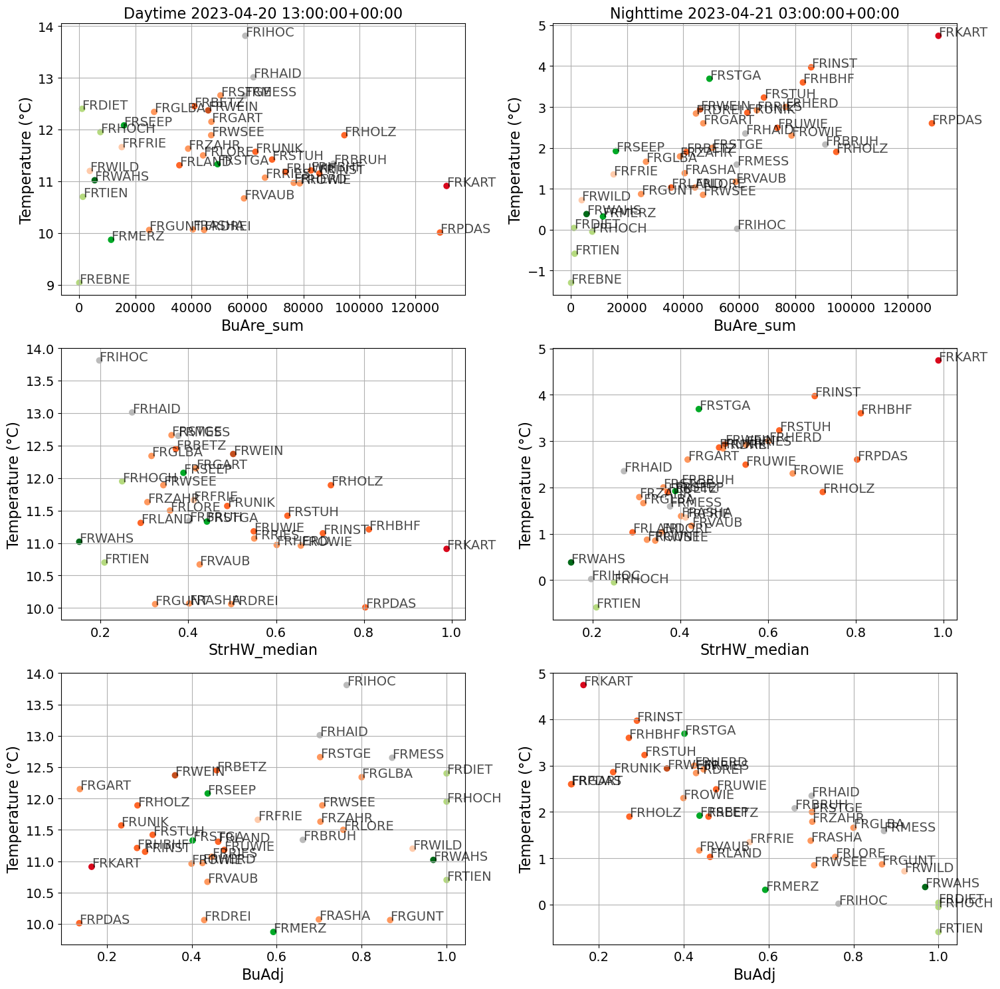

In [12]:
daytime = '2023-04-20 13:00:00+00:00'
nighttime = '2023-04-21 03:00:00+00:00'
plot_dates_area(300, daytime, nighttime)

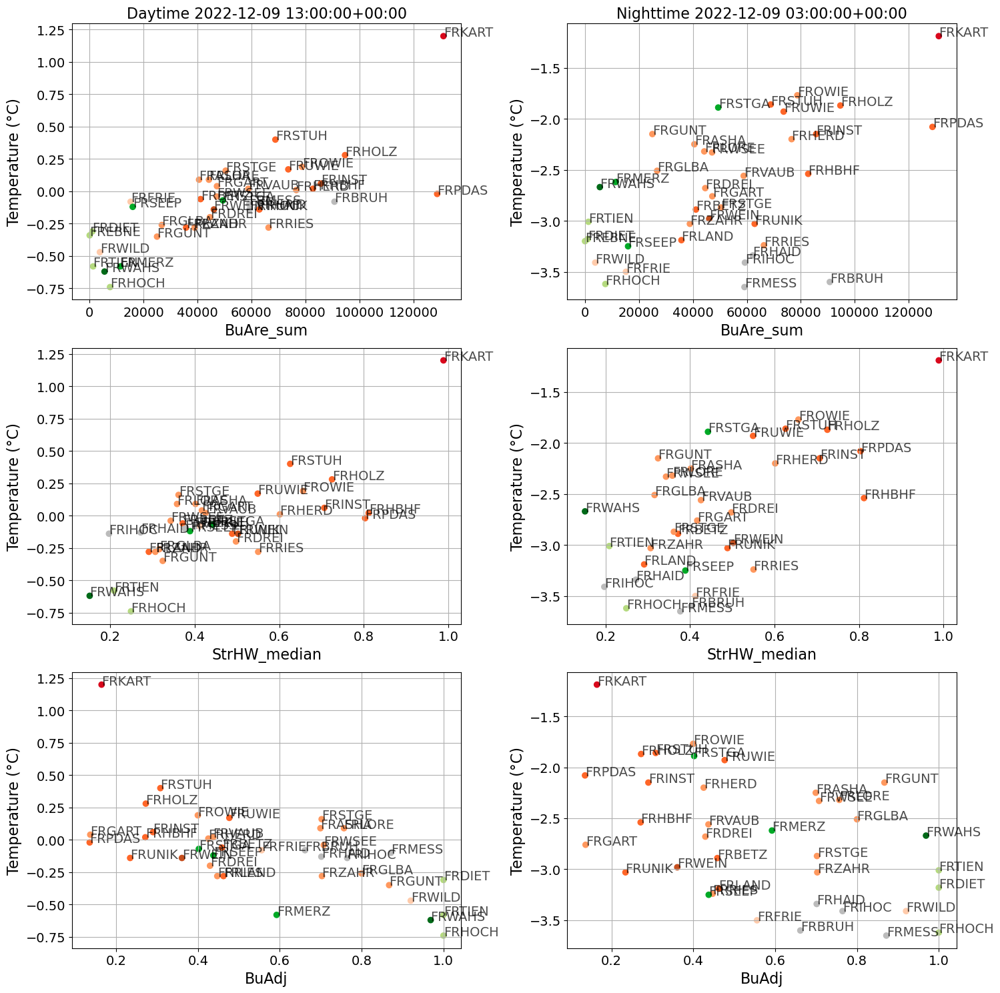

In [14]:
daytime = '2022-12-09 13:00:00+00:00'
nighttime = '2022-12-09 03:00:00+00:00'
plot_dates_area(300, daytime, nighttime)

200 m

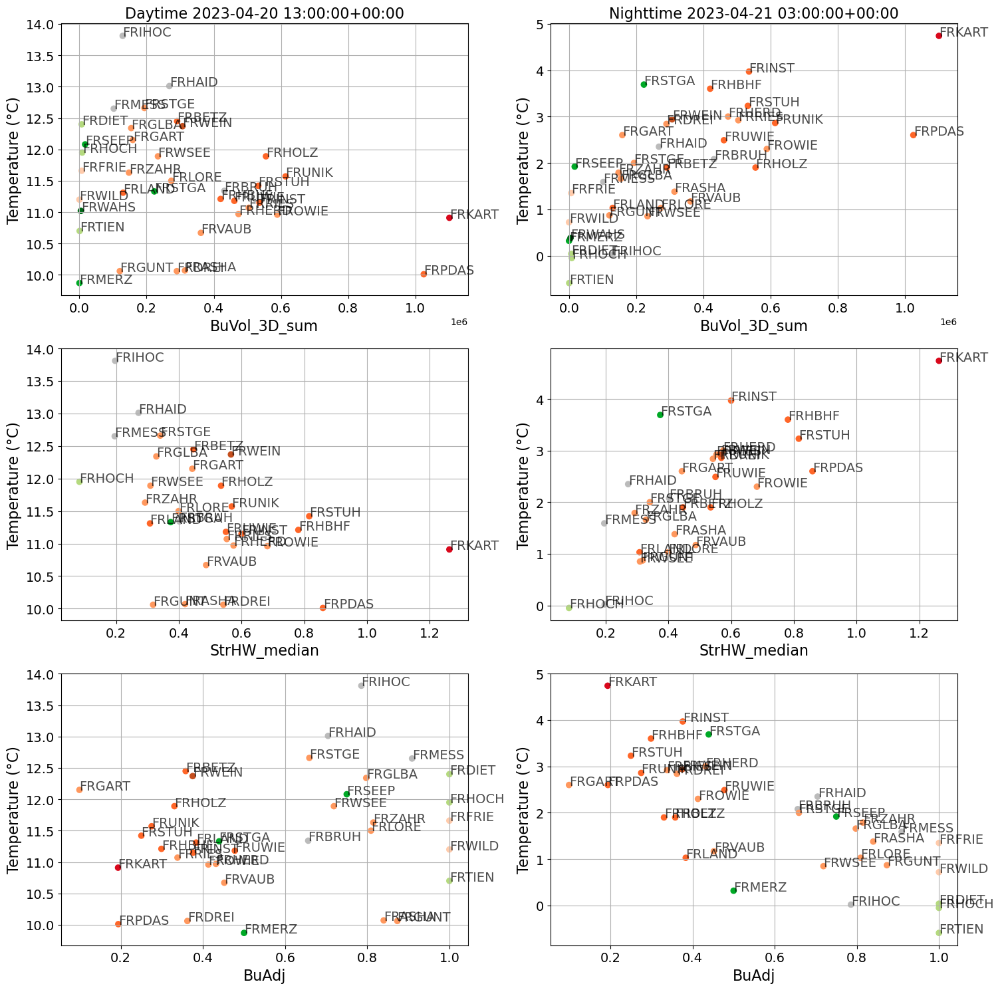

In [61]:
plot_dates(200, daytime, nighttime)

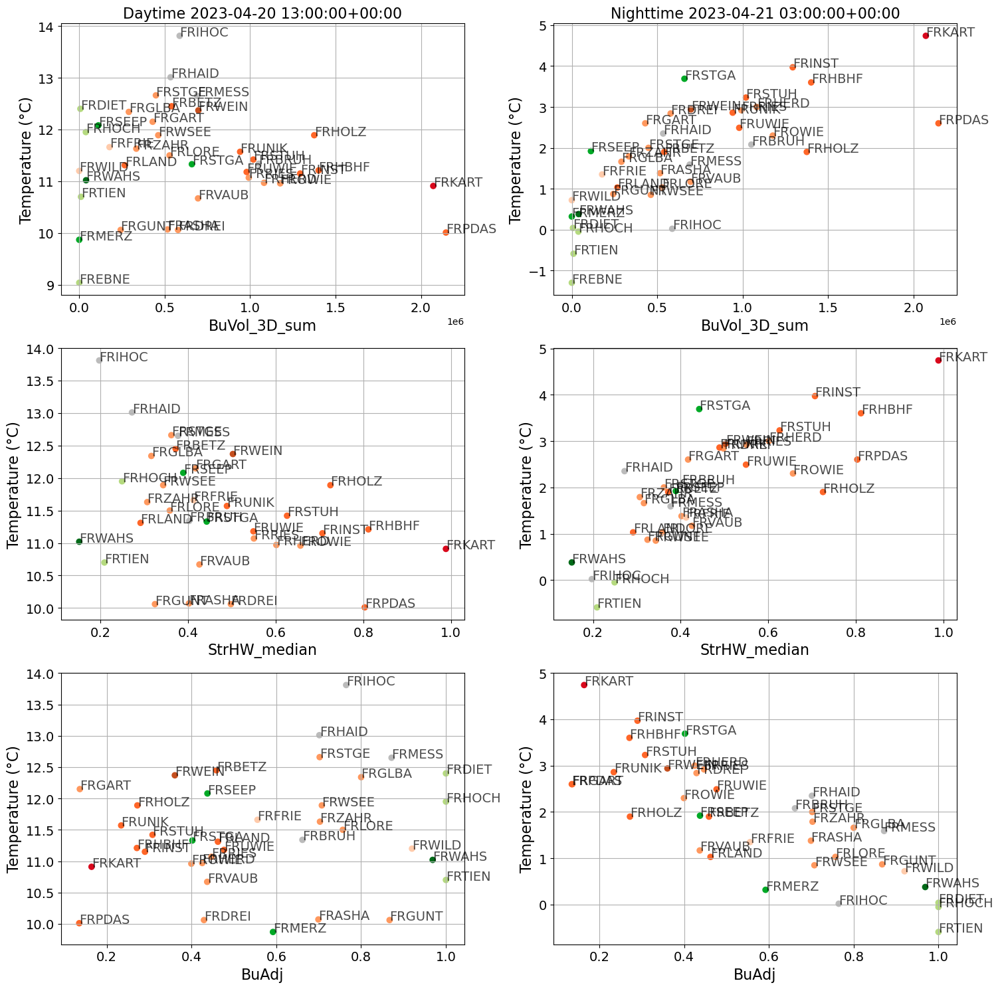

In [64]:
plot_dates(300, daytime, nighttime)

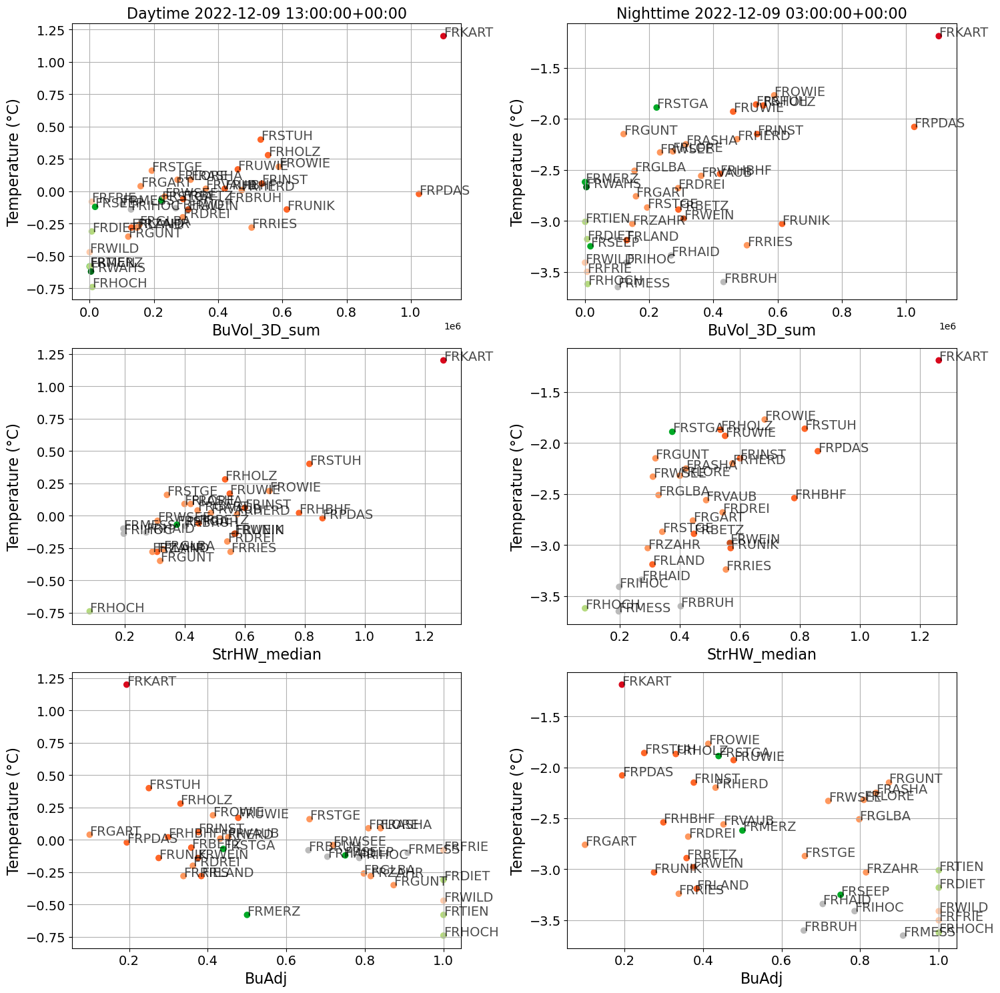

In [62]:
daytime = '2022-12-09 13:00:00+00:00'
nighttime = '2022-12-09 03:00:00+00:00'
plot_dates(200, daytime, nighttime)

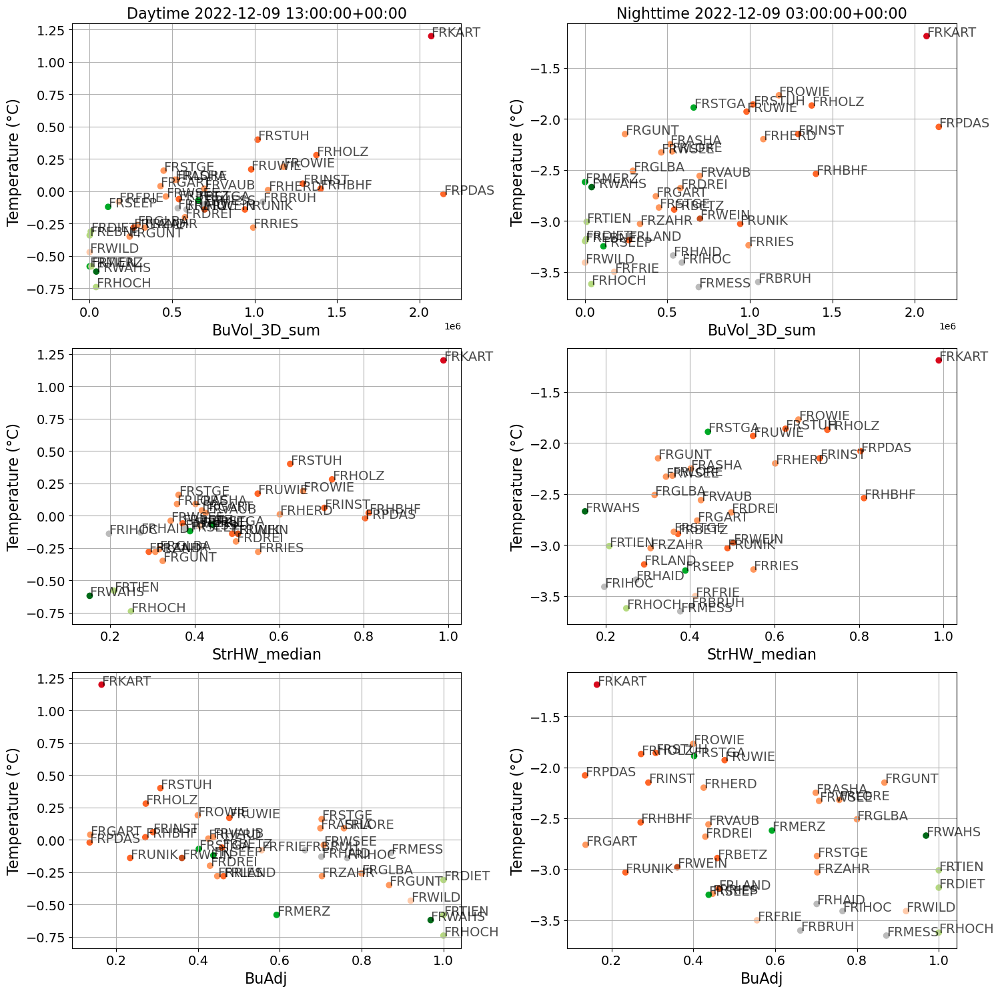

In [65]:
daytime = '2022-12-09 13:00:00+00:00'
nighttime = '2022-12-09 03:00:00+00:00'
plot_dates(300, daytime, nighttime)

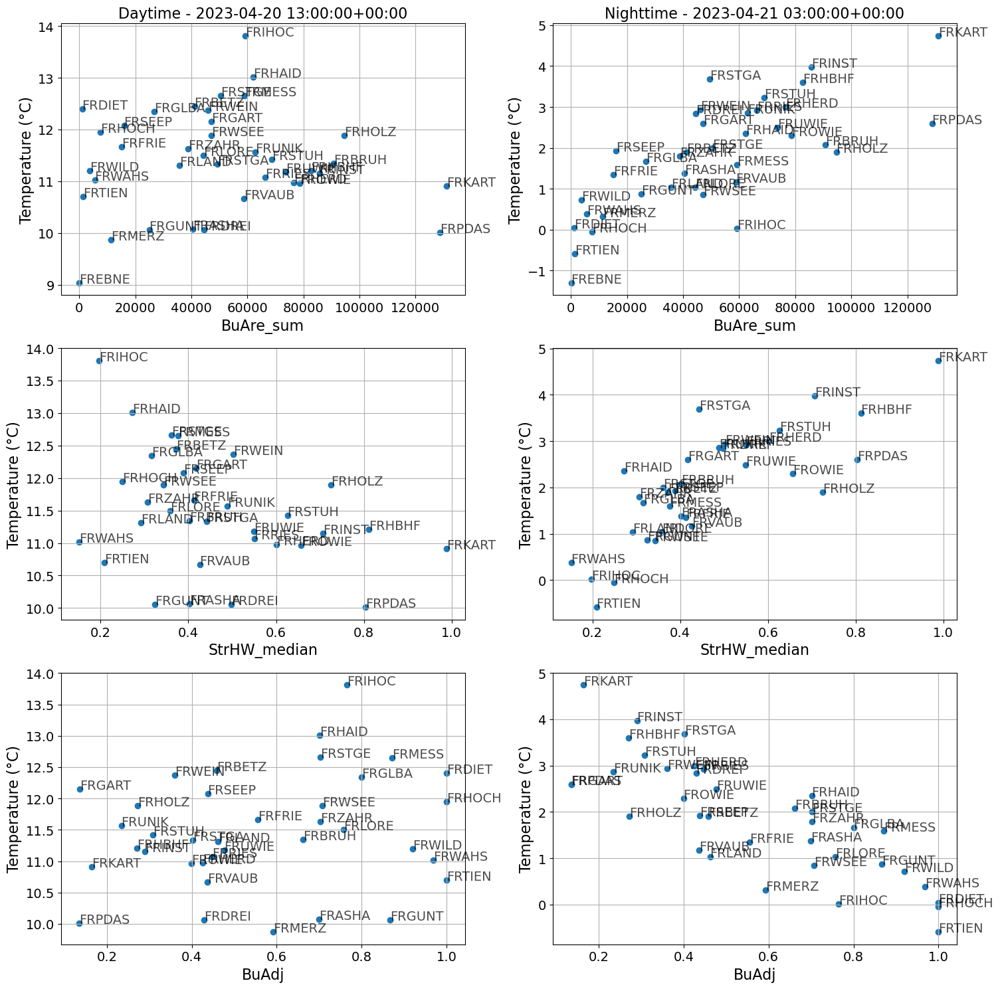

In [23]:
plot_dates(300, daytime, nighttime)

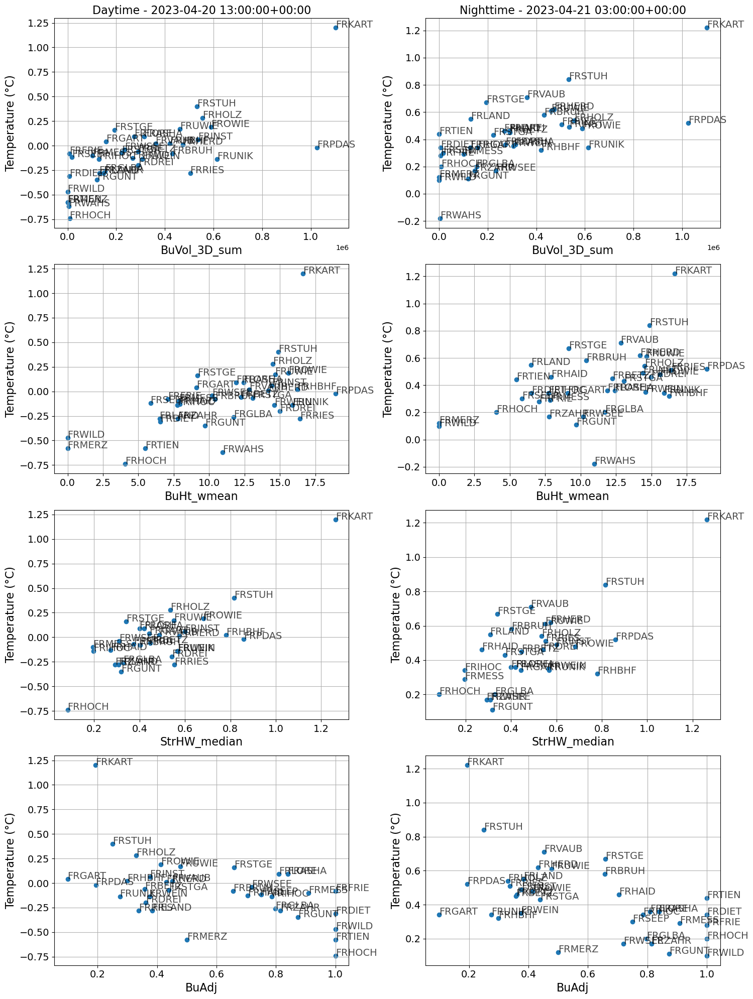

In [17]:
# make 2 x 4 subplots
fig, axs = plt.subplots(4, 2, figsize=(15, 20))

# in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
axs[0, 0].scatter(df['BuVol_3D_sum'], df[daytime])
axs[0, 0].set_title('Daytime - 2023-04-20 13:00:00+00:00', fontsize=16)
axs[0, 0].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 0].grid()
axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 0].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

axs[0, 1].scatter(df['BuVol_3D_sum'], df[nighttime])
axs[0, 1].set_title('Nighttime - 2023-04-21 03:00:00+00:00', fontsize=16)
axs[0, 1].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 1].grid()
axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 1].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

# in next 2 subplots plot temperature vs. BuHt_wmean for daytime and nighttime
axs[1, 0].scatter(df['BuHt_wmean'], df[daytime])
axs[1, 0].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 0].grid()
axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 0].annotate(txt, (df['BuHt_wmean'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[1, 1].scatter(df['BuHt_wmean'], df[nighttime])
axs[1, 1].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 1].grid()
axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 1].annotate(txt, (df['BuHt_wmean'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
axs[2, 0].scatter(df['StrHW_median'], df[daytime])
axs[2, 0].set_xlabel('StrHW_median',fontsize=16)
axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 0].grid()
axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[2, 1].scatter(df['StrHW_median'], df[nighttime])
axs[2, 1].set_xlabel('StrHW_median',fontsize=16)
axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 1].grid()
axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. BuFra_3D_wmean for daytime and nighttime
axs[3, 0].scatter(df['BuAdj'], df[daytime])
axs[3, 0].set_xlabel('BuAdj',fontsize=16)
axs[3, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 0].grid()
axs[3, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 0].annotate(txt, (df['BuAdj'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[3, 1].scatter(df['BuAdj'], df[nighttime])
axs[3, 1].set_xlabel('BuAdj',fontsize=16)
axs[3, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 1].grid()
axs[3, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 1].annotate(txt, (df['BuAdj'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

plt.savefig('/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars.png')
plt.tight_layout()
plt.show()

In [22]:
daytime = '2022-12-09 13:00:00+00:00'
nighttime = '2022-12-09 03:00:00+00:00'

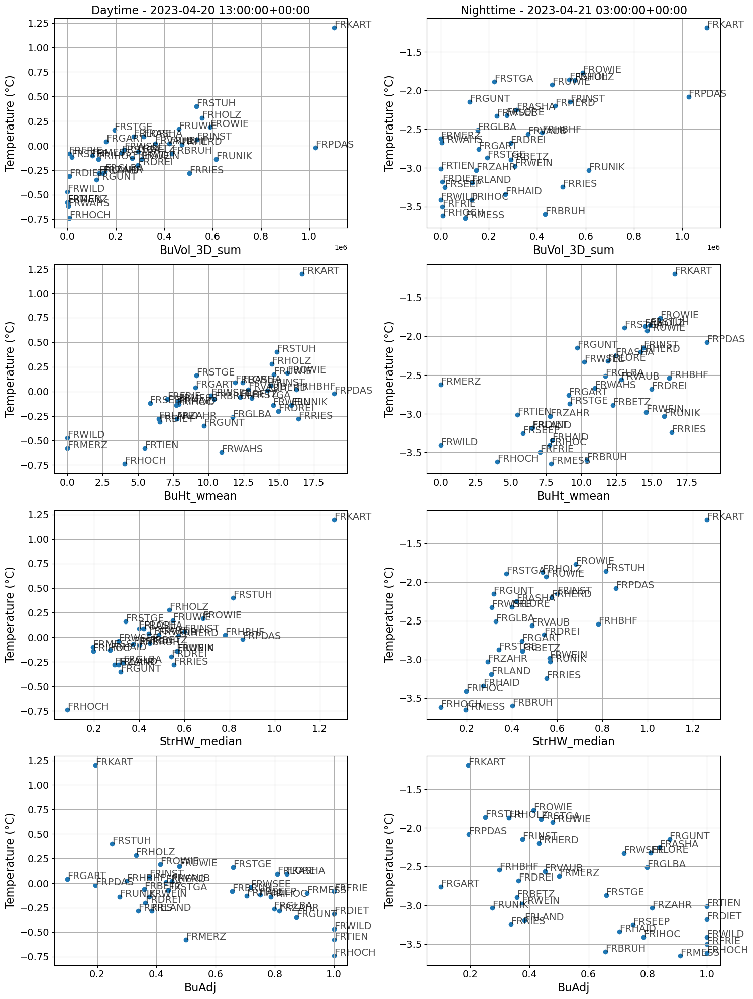

In [23]:
# make 2 x 4 subplots
fig, axs = plt.subplots(4, 2, figsize=(15, 20))

# in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
axs[0, 0].scatter(df['BuVol_3D_sum'], df[daytime])
axs[0, 0].set_title('Daytime - 2023-04-20 13:00:00+00:00', fontsize=16)
axs[0, 0].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 0].grid()
axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 0].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

axs[0, 1].scatter(df['BuVol_3D_sum'], df[nighttime])
axs[0, 1].set_title('Nighttime - 2023-04-21 03:00:00+00:00', fontsize=16)
axs[0, 1].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 1].grid()
axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 1].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

# in next 2 subplots plot temperature vs. BuHt_wmean for daytime and nighttime
axs[1, 0].scatter(df['BuHt_wmean'], df[daytime])
axs[1, 0].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 0].grid()
axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 0].annotate(txt, (df['BuHt_wmean'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[1, 1].scatter(df['BuHt_wmean'], df[nighttime])
axs[1, 1].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 1].grid()
axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 1].annotate(txt, (df['BuHt_wmean'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
axs[2, 0].scatter(df['StrHW_median'], df[daytime])
axs[2, 0].set_xlabel('StrHW_median',fontsize=16)
axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 0].grid()
axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[2, 1].scatter(df['StrHW_median'], df[nighttime])
axs[2, 1].set_xlabel('StrHW_median',fontsize=16)
axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 1].grid()
axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. BuFra_3D_wmean for daytime and nighttime
axs[3, 0].scatter(df['BuAdj'], df[daytime])
axs[3, 0].set_xlabel('BuAdj',fontsize=16)
axs[3, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 0].grid()
axs[3, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 0].annotate(txt, (df['BuAdj'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[3, 1].scatter(df['BuAdj'], df[nighttime])
axs[3, 1].set_xlabel('BuAdj',fontsize=16)
axs[3, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 1].grid()
axs[3, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 1].annotate(txt, (df['BuAdj'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

plt.savefig(f'/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars_{daytime}.png')
plt.tight_layout()
plt.show()

In [26]:
daytime = '2023-08-27 13:00:00+00:00'
nighttime = '2023-08-27 03:00:00+00:00'

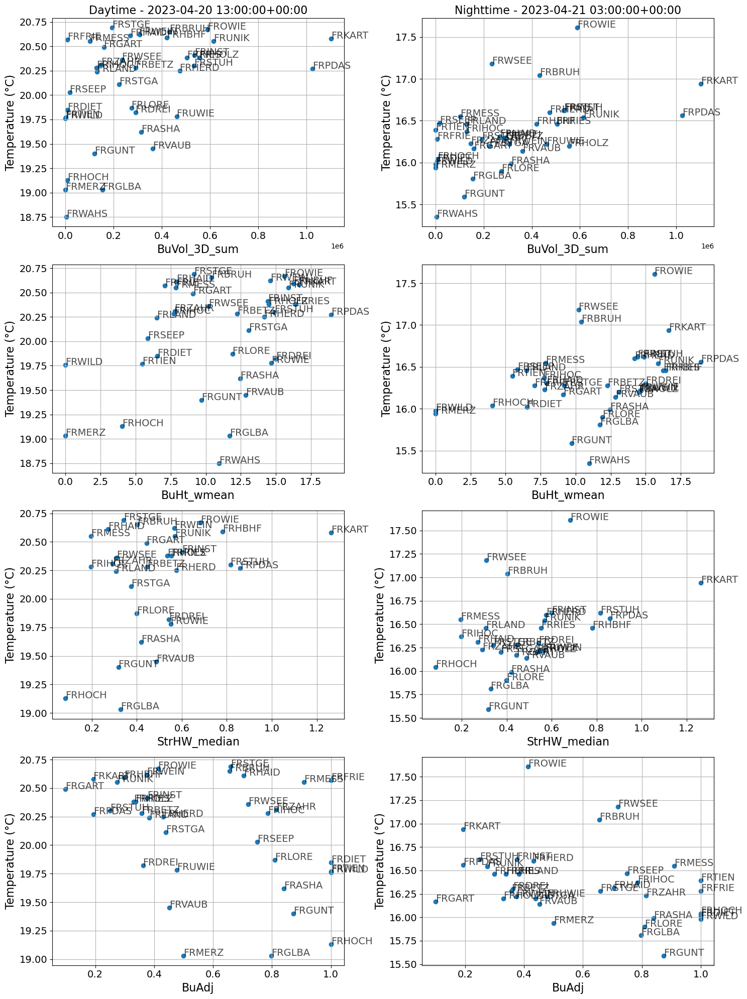

In [27]:
# make 2 x 4 subplots
fig, axs = plt.subplots(4, 2, figsize=(15, 20))

# in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
axs[0, 0].scatter(df['BuVol_3D_sum'], df[daytime])
axs[0, 0].set_title('Daytime - 2023-04-20 13:00:00+00:00', fontsize=16)
axs[0, 0].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 0].grid()
axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 0].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

axs[0, 1].scatter(df['BuVol_3D_sum'], df[nighttime])
axs[0, 1].set_title('Nighttime - 2023-04-21 03:00:00+00:00', fontsize=16)
axs[0, 1].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 1].grid()
axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 1].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

# in next 2 subplots plot temperature vs. BuHt_wmean for daytime and nighttime
axs[1, 0].scatter(df['BuHt_wmean'], df[daytime])
axs[1, 0].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 0].grid()
axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 0].annotate(txt, (df['BuHt_wmean'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[1, 1].scatter(df['BuHt_wmean'], df[nighttime])
axs[1, 1].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 1].grid()
axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 1].annotate(txt, (df['BuHt_wmean'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
axs[2, 0].scatter(df['StrHW_median'], df[daytime])
axs[2, 0].set_xlabel('StrHW_median',fontsize=16)
axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 0].grid()
axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[2, 1].scatter(df['StrHW_median'], df[nighttime])
axs[2, 1].set_xlabel('StrHW_median',fontsize=16)
axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 1].grid()
axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. BuFra_3D_wmean for daytime and nighttime
axs[3, 0].scatter(df['BuAdj'], df[daytime])
axs[3, 0].set_xlabel('BuAdj',fontsize=16)
axs[3, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 0].grid()
axs[3, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 0].annotate(txt, (df['BuAdj'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[3, 1].scatter(df['BuAdj'], df[nighttime])
axs[3, 1].set_xlabel('BuAdj',fontsize=16)
axs[3, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 1].grid()
axs[3, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 1].annotate(txt, (df['BuAdj'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

plt.savefig(f'/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars_{daytime}.png')
plt.tight_layout()
plt.show()

100 m

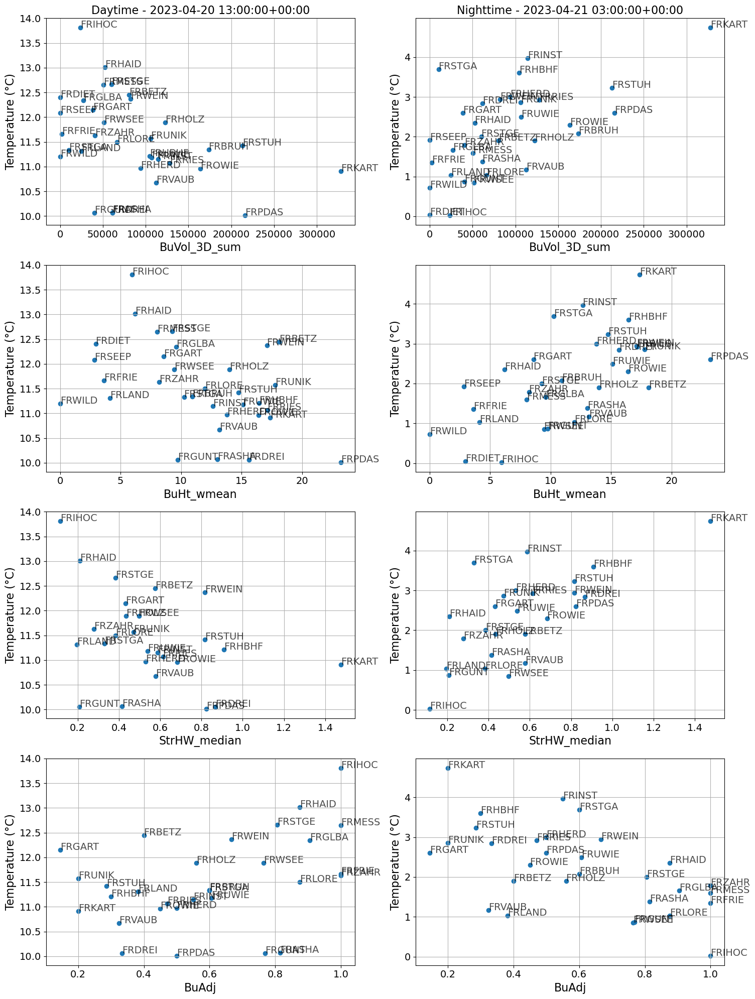

In [12]:
# make 2 x 4 subplots
fig, axs = plt.subplots(4, 2, figsize=(15, 20))

# in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
axs[0, 0].scatter(df['BuVol_3D_sum'], df[daytime])
axs[0, 0].set_title('Daytime - 2023-04-20 13:00:00+00:00', fontsize=16)
axs[0, 0].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 0].grid()
axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 0].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

axs[0, 1].scatter(df['BuVol_3D_sum'], df[nighttime])
axs[0, 1].set_title('Nighttime - 2023-04-21 03:00:00+00:00', fontsize=16)
axs[0, 1].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 1].grid()
axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 1].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

# in next 2 subplots plot temperature vs. BuHt_wmean for daytime and nighttime
axs[1, 0].scatter(df['BuHt_wmean'], df[daytime])
axs[1, 0].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 0].grid()
axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 0].annotate(txt, (df['BuHt_wmean'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[1, 1].scatter(df['BuHt_wmean'], df[nighttime])
axs[1, 1].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 1].grid()
axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 1].annotate(txt, (df['BuHt_wmean'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
axs[2, 0].scatter(df['StrHW_median'], df[daytime])
axs[2, 0].set_xlabel('StrHW_median',fontsize=16)
axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 0].grid()
axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[2, 1].scatter(df['StrHW_median'], df[nighttime])
axs[2, 1].set_xlabel('StrHW_median',fontsize=16)
axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 1].grid()
axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. BuFra_3D_wmean for daytime and nighttime
axs[3, 0].scatter(df['BuAdj'], df[daytime])
axs[3, 0].set_xlabel('BuAdj',fontsize=16)
axs[3, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 0].grid()
axs[3, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 0].annotate(txt, (df['BuAdj'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[3, 1].scatter(df['BuAdj'], df[nighttime])
axs[3, 1].set_xlabel('BuAdj',fontsize=16)
axs[3, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 1].grid()
axs[3, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 1].annotate(txt, (df['BuAdj'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

plt.savefig('/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars.png')
plt.tight_layout()
plt.show()

In [18]:
daytime = '2022-12-09 13:00:00+00:00'
nighttime = '2022-12-10 03:00:00+00:00'

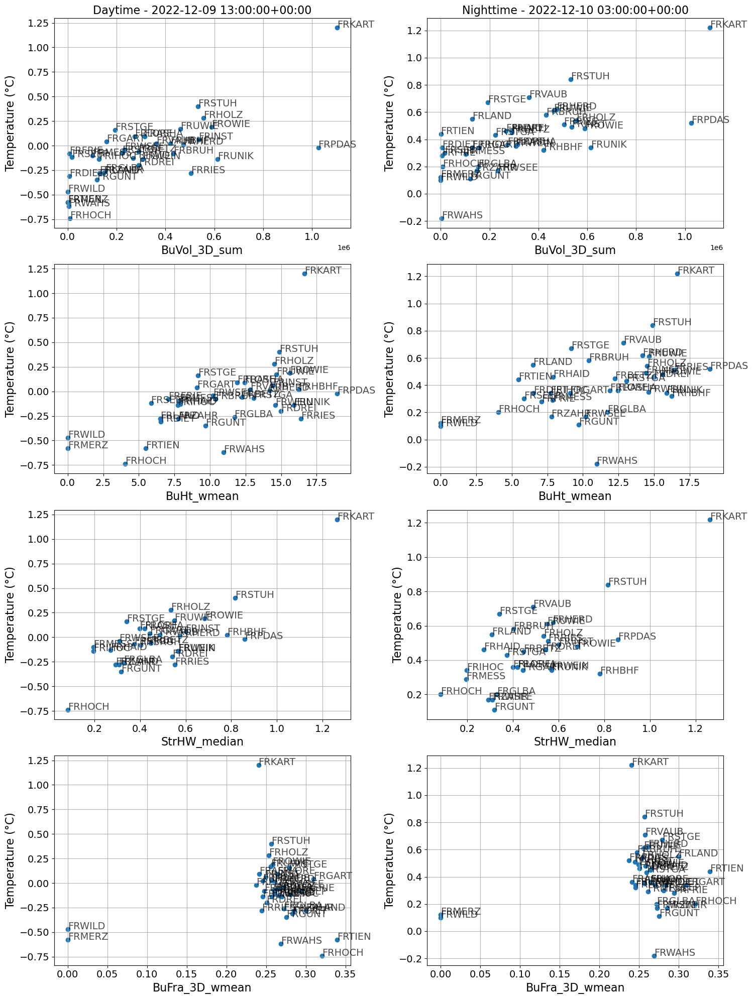

In [19]:
# make 2 x 4 subplots
fig, axs = plt.subplots(4, 2, figsize=(15, 20))

# in first 2 subplots plot temperature vs. BuVol3D_sum for daytime and nighttime
axs[0, 0].scatter(df['BuVol_3D_sum'], df[daytime])
axs[0, 0].set_title('Daytime - 2022-12-09 13:00:00+00:00', fontsize=16)
axs[0, 0].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 0].grid()
axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 0].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)

axs[0, 1].scatter(df['BuVol_3D_sum'], df[nighttime])
axs[0, 1].set_title('Nighttime - 2022-12-10 03:00:00+00:00', fontsize=16)
axs[0, 1].set_xlabel('BuVol_3D_sum',fontsize=16)
axs[0, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[0, 1].grid()
axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[0, 1].annotate(txt, (df['BuVol_3D_sum'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

# in next 2 subplots plot temperature vs. BuHt_wmean for daytime and nighttime
axs[1, 0].scatter(df['BuHt_wmean'], df[daytime])
axs[1, 0].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 0].grid()
axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 0].annotate(txt, (df['BuHt_wmean'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[1, 1].scatter(df['BuHt_wmean'], df[nighttime])
axs[1, 1].set_xlabel('BuHt_wmean',fontsize=16)
axs[1, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[1, 1].grid()
axs[1, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[1, 1].annotate(txt, (df['BuHt_wmean'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. StrHW_median for daytime and nighttime
axs[2, 0].scatter(df['StrHW_median'], df[daytime])
axs[2, 0].set_xlabel('StrHW_median',fontsize=16)
axs[2, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 0].grid()
axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 0].annotate(txt, (df['StrHW_median'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[2, 1].scatter(df['StrHW_median'], df[nighttime])
axs[2, 1].set_xlabel('StrHW_median',fontsize=16)
axs[2, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[2, 1].grid()
axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[2, 1].annotate(txt, (df['StrHW_median'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)


# in next 2 subplots plot temperature vs. BuFra_3D_wmean for daytime and nighttime
axs[3, 0].scatter(df['BuFra_3D_wmean'], df[daytime])
axs[3, 0].set_xlabel('BuFra_3D_wmean',fontsize=16)
axs[3, 0].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 0].grid()
axs[3, 0].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 0].annotate(txt, (df['BuFra_3D_wmean'].iloc[i], df[daytime].iloc[i]), fontsize=14, alpha=0.7)


axs[3, 1].scatter(df['BuFra_3D_wmean'], df[nighttime])
axs[3, 1].set_xlabel('BuFra_3D_wmean',fontsize=16)
axs[3, 1].set_ylabel('Temperature (°C)',fontsize=16)
axs[3, 1].grid()
axs[3, 1].tick_params(axis='both', which='major', labelsize=14)
for i, txt in enumerate(df.index):
    axs[3, 1].annotate(txt, (df['BuFra_3D_wmean'].iloc[i], df[nighttime].iloc[i]), fontsize=14, alpha=0.7)

plt.savefig('/Users/lisawink/Documents/paper1/figures/daytime_vs_nighttime_select_vars_same_trend.png')
plt.tight_layout()
plt.show()

In [11]:
temp[[daytime]]

datetime_UTC,2022-12-09 13:00:00+00:00
station_id,
FRASHA,0.09
FRBETZ,-0.06
FRBRUH,-0.08
FRDIET,-0.31
FRDREI,-0.20
FREBNE,-0.34
FREICH,-1.97
FRFRIE,-0.08
FRGART,0.04


In [ ]:
# completely overcast day + snow and mist